In [1]:
import findspark

def is_notebook():
    try:
        get_ipython()
        return True
    except NameError:
        return False

if is_notebook():
    findspark.init('/lib/spark')
    import pyspark

    spark = pyspark.sql.SparkSession \
        .builder \
        .config("spark.submit.deployMode", "client") \
        .config("spark.submit.deployMode", "client") \
        .config("spark.master", "local[*]") \
        .enableHiveSupport() \
        .appName("default") \
        .getOrCreate()
else:
    import pyspark
    spark = pyspark.sql.SparkSession.builder.getOrCreate()

Setting default log level to "WARN".
To adjust logging level use sc.setLogLevel(newLevel). For SparkR, use setLogLevel(newLevel).


23/04/22 15:28:38 WARN NativeCodeLoader: Unable to load native-hadoop library for your platform... using builtin-java classes where applicable
23/04/22 15:28:40 WARN Utils: Service 'SparkUI' could not bind on port 4040. Attempting port 4041.
23/04/22 15:28:40 WARN Utils: Service 'SparkUI' could not bind on port 4041. Attempting port 4042.
23/04/22 15:28:40 WARN Utils: Service 'SparkUI' could not bind on port 4042. Attempting port 4043.
23/04/22 15:28:40 WARN Utils: Service 'SparkUI' could not bind on port 4043. Attempting port 4044.
23/04/22 15:28:40 WARN Utils: Service 'SparkUI' could not bind on port 4044. Attempting port 4045.
23/04/22 15:28:40 WARN Utils: Service 'SparkUI' could not bind on port 4045. Attempting port 4046.
23/04/22 15:28:40 WARN Utils: Service 'SparkUI' could not bind on port 4046. Attempting port 4047.
23/04/22 15:28:40 WARN Utils: Service 'SparkUI' could not bind on port 4047. Attempting port 4048.
23/04/22 15:28:40 WARN Utils: Service 'SparkUI' could not bind on

In [2]:
import pandas as pd


# 필요한 라이브러리 불러오기
import plotly.io as pio
import plotly.offline as pyo
import plotly.express as px
import plotly.graph_objs as go
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
from plotly.validators.scatter.marker import SymbolValidator


# 오프라인 모드로 변경하기
pyo.init_notebook_mode()

## 스트리머별 시간에 따른 시청자 수 변화(2023-04-08 ~ 2023-04-20)

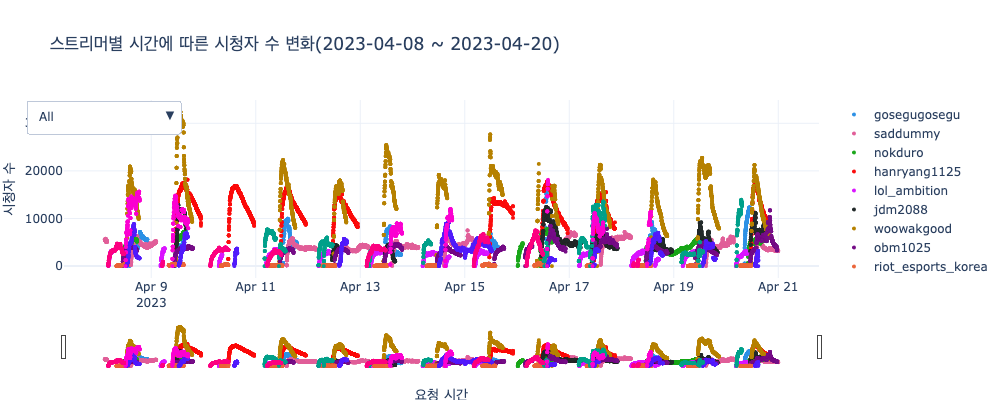

In [3]:
import warnings
warnings.filterwarnings("ignore", message="Passing unit-less datetime64 dtype to .astype is deprecated")
df = spark.sql('''
SELECT 
    id,
    started_at,
    request_time,
    title,
    user_login,
    viewer_count
FROM y_twitch.stream
WHERE request_time BETWEEN '2023-04-08 00:00:00' AND '2023-04-20 23:59:59'
ORDER BY request_time
''')
pdf = df.toPandas()

# 사용자 리스트 가져오기
users = df.select('user_login').distinct().rdd.flatMap(lambda x: x).collect()

# 색상 팔레트 설정
colors = px.colors.qualitative.Dark24[:len(users)]

# Plotly 그래프 생성
fig = go.Figure()

# 각 사용자별로 데이터 필터링하여 그래프에 추가
for i, user in enumerate(users):
    data = pdf[pdf['user_login'] == user]
    fig.add_trace(go.Scatter(x=data['request_time'], y=data['viewer_count'], name=user, mode='markers', marker_size=4, line=dict(color=colors[i], width=1.5)))

# Updatemenus 생성
updatemenus=[dict(
            active=0,
            buttons=list([dict(label='All',
                                method='update',
                                args=[{'visible': [True] * len(users)},
                                      {'title': 'All Users'}])] + 
                         [dict(label=user,
                               method='update',
                               args=[{'visible': [user == trace.name for trace in fig.data]},
                                     {'title': user}]) for user in users]),
            direction='down',
            showactive=True,
            xanchor='left',
            yanchor='top')]

# 그래프 레이아웃 설정
fig.update_layout(title='스트리머별 시간에 따른 시청자 수 변화(2023-04-08 ~ 2023-04-20)',
                  xaxis_title="요청 시간",
                  yaxis_title="시청자 수",
                  width=1200,
                  height=400,
                  autosize=False,
                  margin=dict(t=100, b=0, l=0, r=0),
                  template="plotly_white",
                  updatemenus=updatemenus,
                  )
fig.update_yaxes(tickformat=".0f")
fig.update_xaxes(rangeslider_visible = True)
fig.show()

## 방송(id)별 평균 시청자수 (2023-04-20 기준)

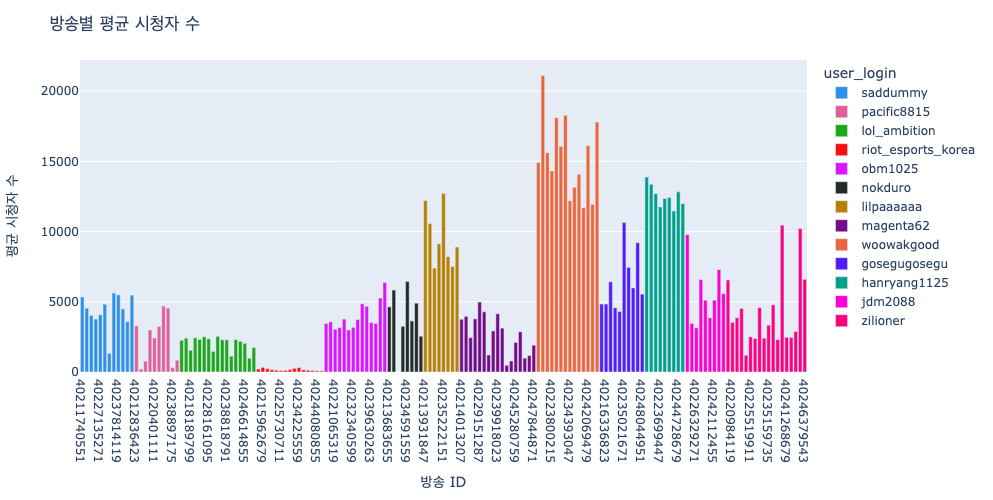

In [4]:
df = spark.sql('''
SELECT 
    id, 
    user_login,
    AVG(viewer_count) AS avg_viewer_count
FROM (
    SELECT 
        id,
        title,
        user_login,
        viewer_count
    FROM y_twitch.stream
)
GROUP BY id, user_login
ORDER BY id
''')#.show(truncate=False)


pdf = df.toPandas()

# 사용자 리스트 가져오기
users = df.select('user_login').distinct().rdd.flatMap(lambda x: x).collect()

colors = px.colors.qualitative.Dark24[:len(users)]

fig = px.bar(pdf, x='id', y='avg_viewer_count', hover_data=['id'], color='user_login', color_discrete_sequence=colors)
fig.update_layout(
    title="방송별 평균 시청자 수",
    xaxis_title="방송 ID",
    yaxis_title="평균 시청자 수",
    width=1000,
    height=500,
    yaxis=dict(tickmode='linear', tick0=0, dtick=5000)
)
fig.update_yaxes(tickformat=".0f")
fig.show()


## 방송별 수집된 채팅 수 (2023-04-20 기준)

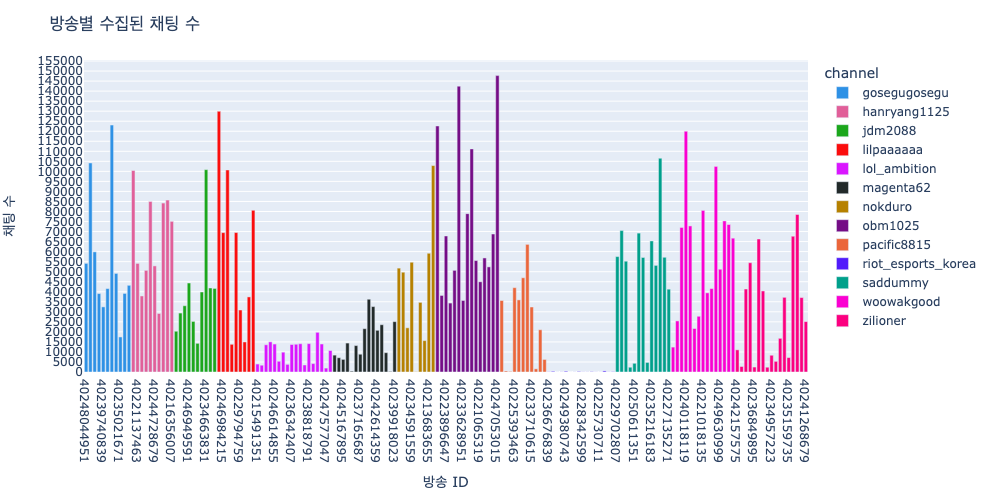

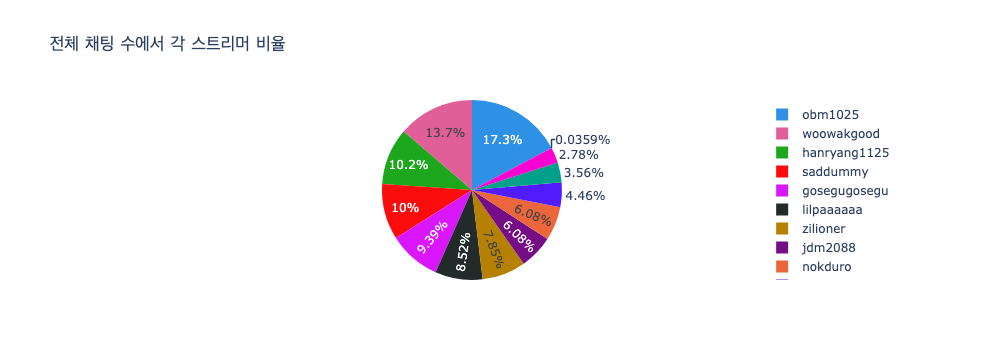

In [5]:
# 스트리머들의 Stream(방송id)별로 구분한 채팅 수

df = spark.sql('''
SELECT 
    channel,
    stream_id,
    SUM(chat_count) as total_chat_count
FROM (
    SELECT 
        stream_id,
        channel,
        count(parameter) as chat_count
    FROM y_twitch.irc
    GROUP BY stream_id, parameter, channel
) tmp
GROUP BY stream_id, channel
ORDER BY channel


''')#.show(500, truncate=False)

pdf = df.toPandas()

users = df.select('channel').distinct().rdd.flatMap(lambda x: x).collect()

colors = px.colors.qualitative.Dark24[:len(users)]

# Pandas DataFrame을 Plotly로 시각화
# fig = px.scatter(pdf, x='request_time', y='viewer_count', hover_data=['started_at', 'title', 'user_login'], color='id')
fig = px.bar(pdf, x='stream_id', y='total_chat_count', hover_data=['stream_id'], color='channel', color_discrete_sequence=colors)
fig.update_layout(
    title="방송별 수집된 채팅 수",
    xaxis_title="방송 ID",
    yaxis_title="채팅 수",
    width=1000,
    height=500,
    yaxis=dict(tickmode='linear', tick0=0, dtick=5000)
)
fig.update_yaxes(tickformat=".0f")
fig.show()

# Pie chart 그리기
fig2 = px.pie(pdf, values='total_chat_count', names='channel', title='전체 채팅 수에서 각 스트리머 비율', color_discrete_sequence=colors)
fig2.show()

## 지금까지 수집한 모든 방송 채팅 수 (2023-04-20 기준)

In [6]:
pdf['total_chat_count'].sum()

6423769

## 스트리머들이 플레이한 게임 종류 (2023-04-20 기준)

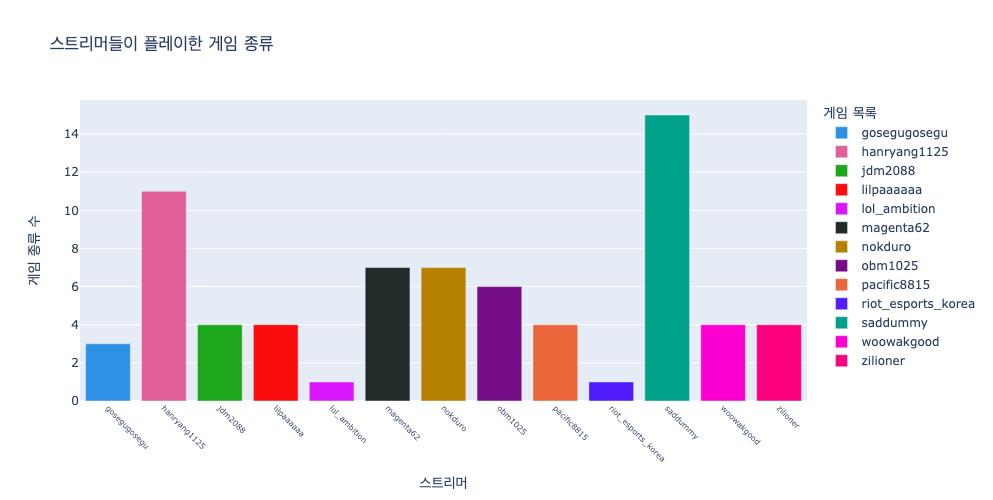

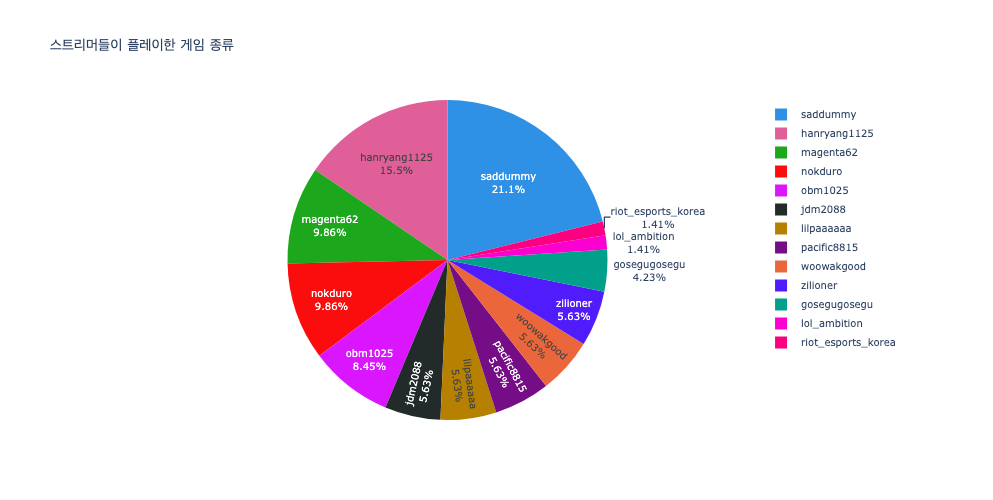

In [7]:
pdf = spark.sql('''
SELECT
    user_login,
    COLLECT_LIST(DISTINCT game_name) AS game_list
FROM (
    SELECT 
        user_login,
        game_name
    FROM y_twitch.stream
    GROUP BY user_login, game_name
) tmp
GROUP BY user_login
ORDER BY user_login
''').toPandas()

pdf['game_list'] = pdf['game_list'].astype(str)

# Plotly를 사용하여 바 차트 시각화
fig = px.bar(pdf, x='user_login', y=pdf['game_list'].apply(lambda x: len(eval(x))),
             color='user_login', text=pdf['game_list'],
             title='스트리머들이 플레이한 게임 종류', height=500, color_discrete_sequence=colors)

fig.update_layout(xaxis_title='스트리머', yaxis_title='게임 종류 수', legend_title='게임 목록')
fig.update_xaxes(tickangle=45)
fig.update_layout(xaxis=dict(tickfont=dict(size=8)))
fig.update_traces(hovertemplate='게임 목록: %{text}<br>게임 종류 수: %{y}', textposition='none')
fig.show()

fig2 = px.pie(pdf, values=pdf['game_list'].apply(lambda x: len(eval(x))), names='user_login',
             title='스트리머들이 플레이한 게임 종류', height=500, color_discrete_sequence=colors)
fig2.update_traces(textinfo='percent+label')
fig2.update_layout(font=dict(size=10))
fig2.show()


## 방송별 채팅 빈도 그래프 (2023-04-20)

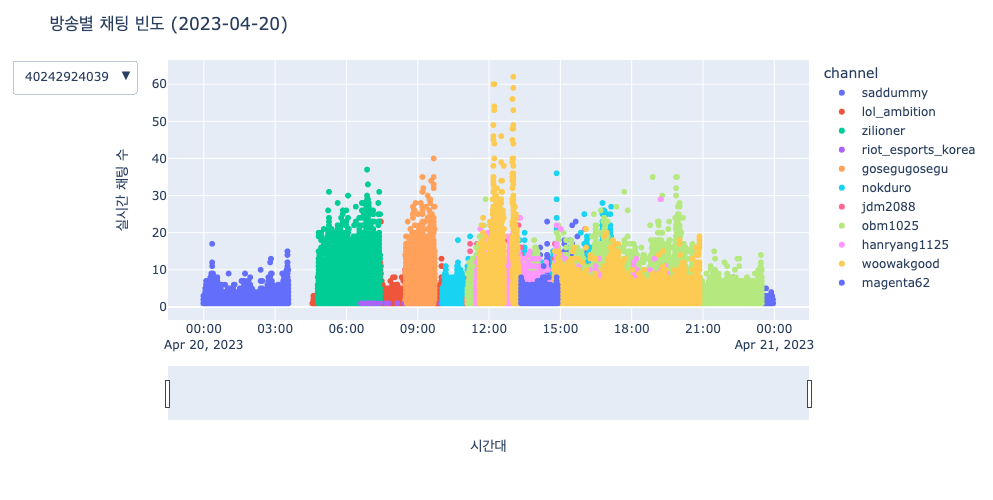

In [8]:
# PySpark DataFrame에서 Pandas DataFrame으로 변환
df = spark.sql('''
    SELECT 
        channel,
        stream_id, 
        timestamp, 
        COUNT(DISTINCT parameter) AS chat_frequency
    FROM y_twitch.irc
    WHERE timestamp BETWEEN '2023-04-20 00:00:00' AND '2023-04-20 23:59:59'
    GROUP BY channel, stream_id, timestamp
    ORDER BY timestamp
''')
pdf = df.toPandas()
# 버튼에 사용될 stream_id 목록
stream_id_list = list(pdf['stream_id'].unique())

# 필터링 함수
def filter_dataframe(stream_id):
    return pdf[pdf['stream_id'] == stream_id]

# 초기 그래프 생성
fig = px.scatter(pdf, x='timestamp', y='chat_frequency', color='channel', hover_data=['stream_id'])

# 버튼 추가
buttons = []
for stream_id in stream_id_list:
    buttons.append(dict(method='update', label=stream_id,
                         args=[{'x': [filter_dataframe(stream_id)['timestamp']],
                                'y': [filter_dataframe(stream_id)['chat_frequency']],
                                'visible': [True if s == stream_id else False for s in stream_id_list]}]))

# 레이아웃 수정
fig.update_layout(
    updatemenus=[dict(buttons=buttons, direction='down', showactive=True)],
    title="방송별 채팅 빈도 (2023-04-20)",
    xaxis_title="시간대",
    yaxis_title="실시간 채팅 수",
    width=1000,
    height=500
)
fig.update_xaxes(rangeslider_visible = True)
fig.show()
